# **Subgroup B Question 3: Linear Programming Optimization**

This notebook demonstrates how to solve an optimization problem using linear programming.
The goal is to **minimize daily average wait time** in Universal Studio Singapore while considering constraints such as resource limits.

Different from `DSA3101_Project_Question B3.py`, this notebook does not implement API. Output in this notebook containes data for all dates and contains visualizations to analyse model performance.

## Problem Formulation

Decision Variable: Staff Allocation

Let:
- $S_{j_t}$  represent the decision variable : Number of staff allocated to attraction i at time t
- The objective is to minimize the daily average wait time function:

$$ \text{Minimize } W(date) = \text{Sum(}\frac{Predicted Demand\times T}{Ride Capacity}\text{)} \times \frac{1}{Number of Rides \times Number of Time Slots}$$


Assume one additional staff can help to reduce time taken for a ride by 0.5 minutes (30 seconds)
$$ T = Ride Duration + [Additional Time - 0.5(S_j - S_{j}min)] $$

where,
- $S_{j,t}$ = Number of staff allocated to ride j

- $S_{j,t}min$ = Min # of staff needed for ride j



Subject to the following constraints:

- $S_{j,t} \geq \text{Minimum number of staff per ride}$

- $\sum_{j=1}^{n} S_{j,t} \leq $ Total Number of Staff (Subject to seasonal variation)

## Importing Libraries

We'll use the `pyomo` library to define and solve the linear programming problem.



In [1]:
import pandas as pd
from pyomo.environ import *
from datetime import datetime, date, time
import sqlite3


## Importing CSV files

In [2]:
wait_times_df = pd.read_csv('../../data/processed/uss_processed_wait_times.csv')
ride_details_df = pd.read_csv('../../data/raw/uss_ride_details.csv')
#holidays_df = pd.read_csv('holidays_data copy.csv')

## Data Pre-Processing

In [3]:
sheet_2023 = pd.read_excel('../../data/processed/uss_sg_holidays.xls', sheet_name="2023")
sheet_2024 = pd.read_excel('../../data/processed/uss_sg_holidays.xls', sheet_name="2024")

conn = sqlite3.connect(":memory:")

# Load dataframes into SQL tables
sheet_2023.to_sql("holidays_2023", conn, index=False, if_exists="replace")
sheet_2024.to_sql("holidays_2024", conn, index=False, if_exists="replace")

# Join the tables with SQL and load the result into a new DataFrame
query = """
SELECT * FROM holidays_2023
UNION
SELECT * FROM holidays_2024
"""
holidays_df = pd.read_sql(query, conn)

# Close the connection
conn.close()

holidays_df['date'] = pd.to_datetime(holidays_df['date'])
holidays_df['date'] = holidays_df['date'].dt.date

#holidays_df.head()  # Display the first few rows



In [4]:
ride_details_df['Duration (s)'] = pd.to_numeric(ride_details_df['Duration (s)'], errors='coerce')
ride_details_df['Capacity per launch'] = pd.to_numeric(ride_details_df['Capacity per launch'], errors='coerce')

unique_time_slots = wait_times_df['Date Time'].str.split(' ').str[1].unique().tolist()
unique_dates = wait_times_df['Date Time'].str.split(' ').str[0].unique().tolist()
unique_rides = ride_details_df['Ride'].unique().tolist()

In [5]:
# Convert date format in holidays_df to match date format in wait_times_df
holidays_df['date'] = holidays_df['date'].apply(lambda x: x.strftime('%y-%m-%d'))
# Convert holiday dates to a set for easy lookup
holidays = set(holidays_df['date'])

# Define a function to check if a date is a holiday
def is_holiday(date):
    return date in holidays

## Creating Dictionaries

In [6]:
# Create necessary dictionaries for easier data retrieval later

guests_entering_ride = {}
for _, row in ride_details_df.iterrows():
    ride = row['Ride']
    if ride not in guests_entering_ride:
        guests_entering_ride[ride] = {}

    guests_entering_ride[ride] = row['Capacity per launch']

# Contains ride duration for each ride
rj = {}
for _, row in ride_details_df.iterrows():
    ride = row['Ride']
    if ride not in rj:
        rj[ride] = {}

    rj[ride] = row['Duration (s)']/60

# Contains additional time needed for each ride (entry, safety checks, exit etc.)
ej = {}
for _, row in ride_details_df.iterrows():
    ride = row['Ride']
    if ride not in ej:
        ej[ride] = {}

    ej[ride] = row['Additional Time']/60


# Contains minimum staff needed for each ride
min_staff = {}
for _, row in ride_details_df.iterrows():
    ride = row['Ride']
    if ride not in min_staff:
        min_staff[ride] = {}


    min_staff[ride] = row['Min Staff']

# Contains maximum staff needed for each ride
max_staff = {}
for _, row in ride_details_df.iterrows():
    ride = row['Ride']
    if ride not in max_staff:
        max_staff[ride] = {}

    max_staff[ride] = row['Max Staff']



The demand of each ride at each time slot is calculated by the following formula:

$$Demand = \frac{Wait Time}{Ride Duration + Additional Time}*Ride Capacity$$

In [7]:
def calculate_demand(row):
    ride = row['Ride']
    wait_time = row['Waittime']
    ride_duration = rj[ride]
    additional_time = ej[ride]
    ride_capacity = guests_entering_ride[ride]  # Ride capacity from ride_details.csv

    # Apply the demand formula
    demand = (wait_time / (ride_duration+additional_time)) * ride_capacity
    return round(demand)

# Add a new column to the wait_times_df to store the calculated demand
wait_times_df['Demand'] = wait_times_df.apply(calculate_demand, axis=1)

#print(wait_times_df)

# Create dictionary for demand and waittime
predicted_demand = {}
for _, row in wait_times_df.iterrows():
    date_time = row['Date Time']
    date, time = date_time.split(' ')
    # Check if the date exists in the dictionary, if not, add it
    if date not in predicted_demand:
        predicted_demand[date] = {}

    # Check if the time exists under the current date, if not, add it
    if time not in predicted_demand[date]:
        predicted_demand[date][time] = {}

    # Add the ride and its demand to the dictionary
    predicted_demand[date][time][row['Ride']] = row['Demand']

waittime = {}
for _, row in wait_times_df.iterrows():
    date_time = row['Date Time']
    date, time = date_time.split(' ')
    if date not in waittime:
        waittime[date] = {}

    if time not in waittime[date]:
        waittime[date][time] = {}

    waittime[date][time][row['Ride']] = row['Waittime']

## Defining the Model

We begin by creating a linear programming problem and setting it as a minimization problem.


In [8]:
# Define the model and optimization process for each day
def optimize_for_date(date):
    model = ConcreteModel()

    model.time_slots = Set(initialize= unique_time_slots)
    model.rides = Set(initialize=unique_rides)

    # Decision variables
    model.S = Var(model.time_slots, model.rides, within=NonNegativeReals,
                  bounds=lambda model, time_slot, ride: (min_staff[ride], max_staff[ride]))

    # Ride time function using decision variables directly
    def ride_time(model, time_slot, ride):
        return rj[ride] + ej[ride] - 0.5 * (model.S[time_slot, ride] - min_staff[ride])

    # Objective: Minimize average wait time per day
    def average_wait_time_rule(model):
        total_wait_time = 0
        for ride in model.rides:
            wait_time_for_slot = 0
            for time_slot in model.time_slots:
                ride_wait_time = (predicted_demand[date][time_slot][ride] / guests_entering_ride[ride]) * ride_time(model, time_slot, ride)
                wait_time_for_slot += ride_wait_time
            total_wait_time += wait_time_for_slot
        return total_wait_time / (len(model.time_slots)*len(model.rides))

    #model.average_wait_time = average_wait_time_rule(model)  # Store the average wait time for constraint
    model.obj = Objective(rule=average_wait_time_rule, sense=minimize)

    #model.wait_time_constraint = Constraint(expr=model.average_wait_time >= 31.75)

    def total_staff_constraint_rule(model, time_slot):
        if is_holiday(date):
            return sum(model.S[time_slot, ride] for ride in model.rides) <= 40  # Staff limit 40 for holidays
        else:
            return sum(model.S[time_slot, ride] for ride in model.rides) <= 35  # Staff limit 35 for regular days

    model.total_staff_constraints = Constraint(model.time_slots, rule=total_staff_constraint_rule)

    # Solve the model
    solver = SolverFactory('glpk')
    solver.solve(model)

    # Post-process: Collect results
    staff_allocations = {time_slot: {ride: model.S[time_slot, ride].value for ride in model.rides} for time_slot in model.time_slots}
    wait_times = {}

    for time_slot in model.time_slots:
        wait_times[time_slot] = {}
        for ride in model.rides:
            staff_allocated = model.S[time_slot, ride].value
            #print(rj[ride],ej[ride],staff_allocated,min_staff[ride])
            ride_time_value = rj[ride] + ej[ride] - 0.5 * (staff_allocated - min_staff[ride])
            adjusted_demand = predicted_demand[date][time_slot][ride]
            if adjusted_demand < 0:
                adjusted_demand = 0
            wait_times[time_slot][ride] = (adjusted_demand / guests_entering_ride[ride]) * ride_time_value

    return model, staff_allocations, wait_times

In [9]:
# Calculate Initial (Unoptimized) Daily Average Waiting Time for comparison later
def initial_daily_average_wait_time(date):
    total_wait_time = 0
    for time_slot in unique_time_slots:
        wait_time_for_slot = 0
        for ride in unique_rides:
            wait_time = waittime[date][time_slot][ride]
            wait_time_for_slot += wait_time
        total_wait_time += wait_time_for_slot
    average_wait_time = total_wait_time/ (len(unique_time_slots)*len(unique_rides))
    #print(average_wait_time)
    return average_wait_time

## Results

The optimal solution provides the number of staff to be allocated to each ride to minimize waiting time.


In [10]:
# Combine results for each day
dates = unique_dates
all_wait_times = {}
all_staff_allocations = {}
all_show_schedules = {}
comparison_results = {}

for date in dates:
    # Calculate initial (unoptimized) daily average wait time
    initial_avg_wait_time = initial_daily_average_wait_time(date)

    # Optimize for the current date
    model, staff_allocations, wait_times = optimize_for_date(date)

    # Store the optimized results
    all_wait_times[date] = wait_times
    all_staff_allocations[date] = staff_allocations

    # Calculate optimized daily average wait time
    total_wait_time = sum(wait_times[time_slot][ride] for time_slot in wait_times for ride in wait_times[time_slot])
    optimized_avg_wait_time = total_wait_time / (len(model.time_slots) * len(model.rides))

    # Compare the unoptimized and optimized daily average wait times
    if initial_avg_wait_time != 0:
        improvement = ((initial_avg_wait_time - optimized_avg_wait_time) / initial_avg_wait_time) * 100

    else:

        improvement = 0
    comparison_results[date] = {
        'Initial Avg Wait Time': initial_avg_wait_time,
        'Optimized Avg Wait Time': optimized_avg_wait_time,
        'Improvement (%)': improvement
    }


In [11]:
# Display results
# Wait Time Table
print("Wait Time Table (Optimized):")
#print(pd.DataFrame.from_dict({(date, time_slot): all_wait_times[date][time_slot] for date in all_wait_times for time_slot in all_wait_times[date]}, orient='index'))
wait_time_df = pd.DataFrame.from_dict(
    {(date, time_slot): all_wait_times[date][time_slot] for date in all_wait_times for time_slot in all_wait_times[date]},
    orient='index'
)

# Flatten the multi-index into columns
wait_time_df.index = pd.MultiIndex.from_tuples(wait_time_df.index, names=["Date", "Time Slot"])
wait_time_df = wait_time_df.reset_index()

# Save the Wait Time Table to CSV
wait_time_df.to_csv('output/wait_time_table_optimized.csv', index=False)
print("Wait Time Table saved as 'wait_time_table_optimized.csv'")



Wait Time Table (Optimized):
Wait Time Table saved as 'wait_time_table_optimized.csv'


#### **Visualization On Optimized Wait Times**

In [12]:
df_pivoted = wait_time_df.melt(id_vars=['Date', 'Time Slot'], var_name='attraction', value_name='waittime')
df_pivoted['datetime'] = pd.to_datetime(df_pivoted['Date'] + ' ' + df_pivoted['Time Slot'])
df_pivoted.drop(columns=['Date', 'Time Slot'], inplace=True)

import folium
from folium.plugins import TimestampedGeoJson

attraction_coords = pd.read_csv("../../data/raw/uss_attractions_locations.csv")[['name', 'lat', 'long']]
attraction_coords.columns = attraction_coords.columns.str.strip()

df_pivoted['queue_category'] = pd.cut(
    df_pivoted['waittime'],
    bins=[-float('inf'), df_pivoted['waittime'].quantile(0.33), df_pivoted['waittime'].quantile(0.66), float('inf')],
    labels=['Low', 'Medium', 'High']
)

merged_df = pd.merge(df_pivoted, attraction_coords, left_on='attraction', right_on='name', how='left')

merged_df['datetime'] = pd.to_datetime(merged_df['datetime'], format = '%Y-%m-%d %H:%M:%S')


features = []
for _, row in merged_df.iterrows():
      features.append({
          'type': 'Feature',
          'geometry': {
              'type': 'Point',
              'coordinates': [row['long'], row['lat']]
          },
          'properties': {
              'time': row['datetime'].isoformat(),
              'style': {
                  'color': 'red' if row['queue_category'] == 'High' else 'orange' if row['queue_category'] == 'Medium' else 'green',
                  'radius': row['waittime'] / 3
              },
              'icon': 'circle',
          }
      })


map_center = [merged_df['lat'].mean(), merged_df['long'].mean()]
m = folium.Map(location=map_center, zoom_start=17)


TimestampedGeoJson(
    {
        'type': 'FeatureCollection',
        'features': features
    },
    period='PT30M',
    duration ='PT29M',
    add_last_point=True,
    auto_play=True,
    loop=True,
).add_to(m)

m


In [13]:
# Staff Allocation Table
print("\nStaff Allocation Table (Optimized):")
#print(pd.DataFrame.from_dict({(date, time_slot): all_staff_allocations[date][time_slot] for date in all_staff_allocations for time_slot in all_staff_allocations[date]}, orient='index'))
# Staff Allocation Table (Optimized)
staff_alloc_df = pd.DataFrame.from_dict(
    {(date, time_slot): all_staff_allocations[date][time_slot] for date in all_staff_allocations for time_slot in all_staff_allocations[date]},
    orient='index'
)

# Flatten the multi-index into columns
staff_alloc_df.index = pd.MultiIndex.from_tuples(staff_alloc_df.index, names=["Date", "Time Slot"])
staff_alloc_df = staff_alloc_df.reset_index()

# Save the Staff Allocation Table to CSV
staff_alloc_df.to_csv('output/staff_allocation_table_optimized.csv', index=False)
print("Staff Allocation Table saved as 'staff_allocation_table_optimized.csv'")



Staff Allocation Table (Optimized):
Staff Allocation Table saved as 'staff_allocation_table_optimized.csv'


## Comparison of Initial vs Optimized Daily Average Wait Times

In [14]:
# Comparison of Initial vs Optimized Daily Average Wait Times
print("\nComparison of Initial vs Optimized Daily Average Wait Times:")
for date in comparison_results:
    print(f"\nResults for {date}:")
    print(f"  Initial Avg Wait Time: {comparison_results[date]['Initial Avg Wait Time']:.2f} minutes")
    print(f"  Optimized Avg Wait Time: {comparison_results[date]['Optimized Avg Wait Time']:.2f} minutes")
    print(f"  Improvement: {comparison_results[date]['Improvement (%)']:.2f}%")


Comparison of Initial vs Optimized Daily Average Wait Times:

Results for 2023-01-02:
  Initial Avg Wait Time: 30.74 minutes
  Optimized Avg Wait Time: 26.25 minutes
  Improvement: 14.62%

Results for 2023-01-03:
  Initial Avg Wait Time: 0.00 minutes
  Optimized Avg Wait Time: 0.00 minutes
  Improvement: 0.00%

Results for 2023-01-04:
  Initial Avg Wait Time: 28.91 minutes
  Optimized Avg Wait Time: 25.13 minutes
  Improvement: 13.08%

Results for 2023-01-05:
  Initial Avg Wait Time: 21.53 minutes
  Optimized Avg Wait Time: 18.66 minutes
  Improvement: 13.34%

Results for 2023-01-06:
  Initial Avg Wait Time: 21.77 minutes
  Optimized Avg Wait Time: 18.77 minutes
  Improvement: 13.81%

Results for 2023-01-07:
  Initial Avg Wait Time: 17.63 minutes
  Optimized Avg Wait Time: 15.43 minutes
  Improvement: 12.45%

Results for 2023-01-08:
  Initial Avg Wait Time: 12.56 minutes
  Optimized Avg Wait Time: 10.89 minutes
  Improvement: 13.31%

Results for 2023-01-09:
  Initial Avg Wait Time: 17

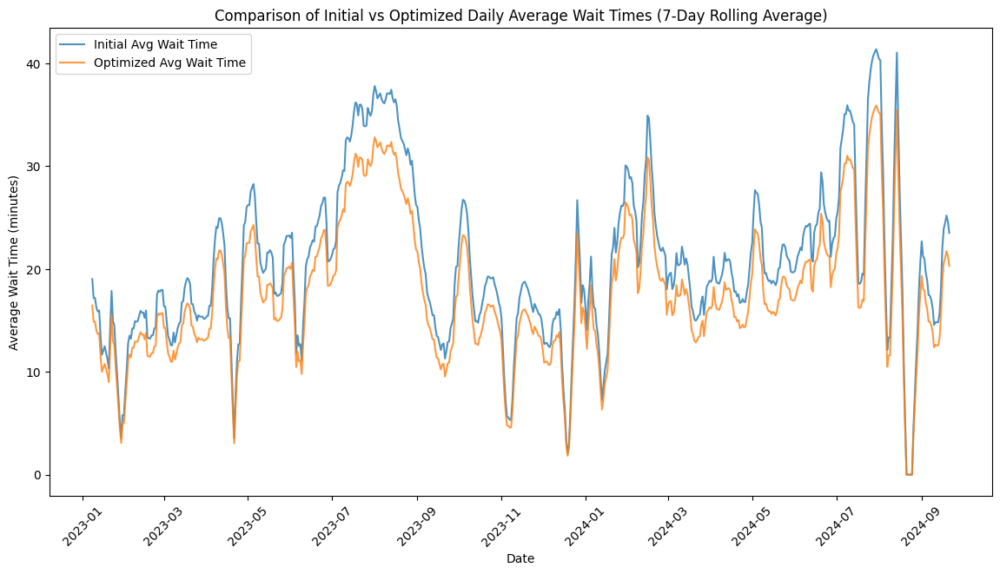

In [15]:
import matplotlib.pyplot as plt

# Data preparation for plotting
dates = list(comparison_results.keys())
initial_wait_times = [comparison_results[date]['Initial Avg Wait Time'] for date in dates]
optimized_wait_times = [comparison_results[date]['Optimized Avg Wait Time'] for date in dates]
improvements = [comparison_results[date]['Improvement (%)'] for date in dates]

# Convert lists to DataFrame for easier manipulation (e.g., rolling average)
data = pd.DataFrame({
    'Date': dates,
    'Initial Avg Wait Time': initial_wait_times,
    'Optimized Avg Wait Time': optimized_wait_times
})
data['Date'] = pd.to_datetime(data['Date'])  # Convert dates for better handling
data.set_index('Date', inplace=True)

# Apply rolling average to smooth the lines (adjust window size as needed)
data['Initial Avg Wait Time'] = data['Initial Avg Wait Time'].rolling(window=7).mean()
data['Optimized Avg Wait Time'] = data['Optimized Avg Wait Time'].rolling(window=7).mean()

# Plotting the initial vs optimized wait times as smoothed line plots
plt.figure(figsize=(14, 7))

# Line plot for Initial and Optimized Wait Times with reduced markers
plt.plot(data.index, data['Initial Avg Wait Time'], label='Initial Avg Wait Time', linewidth=1.5, alpha=0.8)
plt.plot(data.index, data['Optimized Avg Wait Time'], label='Optimized Avg Wait Time', linewidth=1.5, alpha=0.8)

# Adding labels and title
plt.xlabel('Date')
plt.ylabel('Average Wait Time (minutes)')
plt.title('Comparison of Initial vs Optimized Daily Average Wait Times (7-Day Rolling Average)')
plt.xticks(rotation=45)
plt.legend()

plt.show()


## Further Analysis

In [16]:
# Load the CSV file
#file_path = 'output/wait_time_table_optimized.csv' 
file2_path = '../../data/processed/uss_processed_wait_times.csv'
#df = pd.read_csv(file_path)
initial_waittime_df = pd.read_csv(file2_path)
initial_waittime_df

file = '/Users/kayi/Desktop/DSA3101/Q2 revised/uss_ride_details.csv'
minstaffdf = pd.read_csv(file, usecols=['Ride','Min Staff'])

staff = '/Users/kayi/Desktop/DSA3101/Q2 revised/staff_allocation_table_optimized.csv'
staffdf = pd.read_csv(staff)

# Calculate the average wait time for each ride
# Exclude 'Date_Time' and 'Time Slot' columns from the calculation
ride_columns = [col for col in wait_time_df.columns if col not in ['Date', 'Time Slot']]
staff_ride_columns = [col for col in wait_time_df.columns if col not in ['Date', 'Time Slot']]


optimized_average_wait_times = wait_time_df[ride_columns].mean()
average_staff = staffdf[staff_ride_columns].mean().round()
unoptimized_average_wait_times = initial_waittime_df.groupby('Ride')['Waittime'].mean()
minstaff = minstaffdf.groupby('Ride')['Min Staff'].mean().round()

comparison_df = pd.DataFrame({
    'Unoptimized Mean Wait Time': unoptimized_average_wait_times,
    'Optimized Mean Wait Time': optimized_average_wait_times,
    'Average Staff': average_staff,
    'Min Staff': minstaff
}).dropna()

comparison_df1 = pd.DataFrame({
    'Unoptimized Mean Wait Time': unoptimized_average_wait_times,
    'Optimized Mean Wait Time': optimized_average_wait_times
}).dropna()

new_xtick_labels = ['Accelerator', 'Battlestar CYLON', 'Battlestar HUMAN', 'Canopy Flyer', 'Dino-Soaring', 'Enchanted Airway', 
                    'Jurassic Park', 'Lights Camera Action', 'Magic Potion', 'Puss In Boots', 'Mummy', 'Shrek', 'Transformers','Treasure Hunter'] 


<Figure size 1500x1500 with 0 Axes>

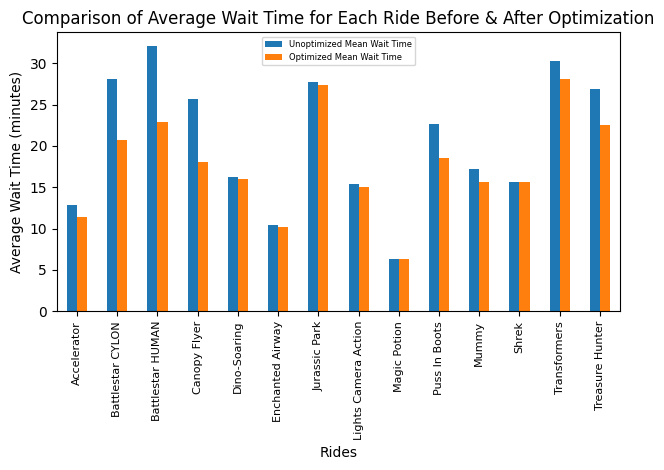

In [17]:
# Plot the comparison bar chart
plt.figure(figsize=(15, 15))
comparison_df1.plot(kind='bar')
plt.title('Comparison of Average Wait Time for Each Ride Before & After Optimization')
plt.xlabel('Rides')
plt.ylabel('Average Wait Time (minutes)')
#plt.xticks(rotation=90, fontsize=8) 
plt.xticks(range(len(new_xtick_labels)), new_xtick_labels, rotation=90, fontsize=8) 
plt.legend(loc='upper center', fontsize=6)
plt.tight_layout()

# Display the plot
plt.show()

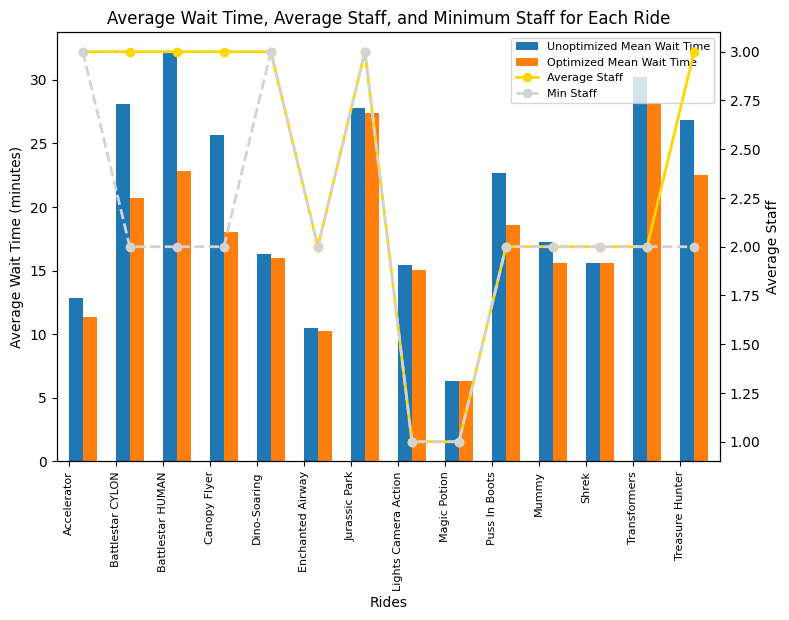

In [18]:
import numpy as np

# Set the figure size
fig, ax1 = plt.subplots(figsize=(8, 8))

# Plot the bar chart for wait times
comparison_df[['Unoptimized Mean Wait Time', 'Optimized Mean Wait Time']].plot(kind='bar', ax=ax1, position=0, width=0.6)
ax1.set_ylabel('Average Wait Time (minutes)')
ax1.set_xlabel('Rides')
ax1.set_title('Average Wait Time, Average Staff, and Minimum Staff for Each Ride')
ax1.set_xticklabels(comparison_df.index, rotation=90, fontsize=8)  # Rotate x-tick labels

# Create a secondary y-axis for the line plot
ax2 = ax1.twinx()

# Generate x positions with a slight offset for the line plot
x_positions = np.arange(len(comparison_df)) + 0.3  # Adjust the offset as needed (0.2 shifts it slightly to the right)
line, = ax2.plot(x_positions, comparison_df['Average Staff'], color='gold', marker='o', label='Average Staff', linewidth=2)
line2, = ax2.plot(x_positions, comparison_df['Min Staff'], color='lightgrey', marker='o', linestyle='--', label='Min Staff', linewidth=2)
ax2.set_ylabel('Average Staff')

# Combine legends from both ax1 and ax2
bars_lines, bars_labels = ax1.get_legend_handles_labels()
ax1.legend(bars_lines + [line, line2], bars_labels + ['Average Staff', 'Min Staff'], loc='upper right', fontsize=8)  # Combined legend

# Adjust layout
plt.tight_layout()
plt.xticks(range(len(new_xtick_labels)), new_xtick_labels, rotation=90, fontsize=8) 

# Display the plot
plt.show()